In [59]:
%load_ext autoreload
%autoreload 2

import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import numpy as np
from waymo_open_dataset import dataset_pb2 as open_dataset
import matplotlib.pyplot as plt
import dask.dataframe as dd
import tensorflow as tf
from waymo_open_dataset import v2
import time
from typing import Any, Dict, Iterator, List, Optional, Sequence, Tuple
from waymo_open_dataset.utils import camera_segmentation_utils
import cv2
import os
tf.compat.v1.enable_eager_execution()

from pvps_dataset import PanopticSegmentationDataset

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [55]:
# I want to know what context_name is in this txt file

def getFramesList(txtFile):
    context_name_list = []
    frames_dict = {}
    list_ = open(txtFile).read().split()
    for line in list_:
        frames_line = line.split(',')
        context_name, time_stamp = frames_line
        if not(context_name in context_name_list):
            context_name_list.append(context_name)
        if not(context_name in frames_dict):
            frames_dict[context_name] = [time_stamp]
        else:
            frames_dict[context_name].append(time_stamp)

    for context_name in frames_dict:
        time_stamp_list = frames_dict[context_name]
        frames_dict[context_name] = sorted(time_stamp_list)
    #     print("======", context_name)
    #     print(len(frames_dict[context_name]))
    #     for time in frames_dict[context_name]:
    #         print(time)
    return context_name_list, frames_dict


txtFile = "./2d_pvps_training_frames.txt"
context_name_list, frames_dict = getFramesList(txtFile)
# context_name_list: [context1, context2, context3, ...]
# frames_dict: {context1: [all timestamps], context2: [all timestamps], ...} # for retrieving timestamp, given context_name

In [ ]:
my_transform = transforms.Compose([
    transforms.ToTensor()
])
frames_id_list_path = txtFile
frames_path = "/media/kaiwenjon/Kevin-linux-dats/waymo/dataset_v2/training/camera_image"
labels_path = "/media/kaiwenjon/Kevin-linux-dats/waymo/dataset_v2/training/camera_segmentation"
datasetNum = None
desired_timestamp = None
# For each context name, read all the data and store it in a folder
for context_name in context_name_list:
    print("Fetching context:", context_name)
    context_folder = f"./data/{context_name}"
    desired_context_name = context_name
    dataset = PanopticSegmentationDataset(frames_path, labels_path, frames_id_list_path, datasetNum, desired_context_name, desired_timestamp, transform=my_transform)
    dataloader = torch.utils.data.DataLoader(dataset, batch_size=1, num_workers=2)
    for batch_idx, (frames, labels) in enumerate(dataloader):
        time_stamp = frames_dict[context_name][batch_idx]
        
        img_FRONT = frames[0][0][0]
        img_FRONT_LEFT = frames[1][0][0]
        img_FRONT_RIGHT = frames[2][0][0]
        img_SIDE_LEFT = frames[3][0][0]
        img_SIDE_RIGHT = frames[4][0][0]

        # torch.Size([batch_size, 1, 1280, 1920])
        semantic_labels_FRONT = labels[0][0][0]
        semantic_labels_FRONT_LEFT = labels[1][0][0]
        semantic_labels_FRONT_RIGHT = labels[2][0][0]
        semantic_labels_SIDE_LEFT = labels[3][0][0]
        semantic_labels_SIDE_RIGHT = labels[4][0][0]

        # torch.Size([batch_size, 1, 1280, 1920])
        instance_labels_FRONT = labels[0][1][0]
        instance_labels_FRONT_LEFT = labels[1][1][0]
        instance_labels_FRONT_RIGHT = labels[2][1][0]
        instance_labels_SIDE_LEFT = labels[3][1][0]
        instance_labels_SIDE_RIGHT = labels[4][1][0]

        # torch.Size([batch_size, 3, 1280, 1920])
        panoptic_rgb_labels_FRONT = labels[0][2][0]
        panoptic_rgb_labels_FRONT_LEFT = labels[1][2][0]
        panoptic_rgb_labels_FRONT_RIGHT = labels[2][2][0]
        panoptic_rgb_labels_SIDE_LEFT = labels[3][2][0]
        panoptic_rgb_labels_SIDE_RIGHT = labels[4][2][0]
        
        os.makedirs(f"./data/{context_name}/{time_stamp}", exist_ok=True)
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/img_FRONT.jpg", cv2.cvtColor(np.float32(img_FRONT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/img_FRONT_LEFT.jpg", cv2.cvtColor(np.float32(img_FRONT_LEFT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/img_FRONT_RIGHT.jpg", cv2.cvtColor(np.float32(img_FRONT_RIGHT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/img_SIDE_LEFT.jpg", cv2.cvtColor(np.float32(img_SIDE_LEFT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/img_SIDE_RIGHT.jpg", cv2.cvtColor(np.float32(img_SIDE_RIGHT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/semantic_labels_FRONT.jpg", cv2.cvtColor(np.float32(semantic_labels_FRONT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/semantic_labels_FRONT_LEFT.jpg", cv2.cvtColor(np.float32(semantic_labels_FRONT_LEFT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/semantic_labels_FRONT_RIGHT.jpg", cv2.cvtColor(np.float32(semantic_labels_FRONT_RIGHT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/semantic_labels_SIDE_LEFT.jpg", cv2.cvtColor(np.float32(semantic_labels_SIDE_LEFT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/semantic_labels_SIDE_RIGHT.jpg", cv2.cvtColor(np.float32(semantic_labels_SIDE_RIGHT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/instance_labels_FRONT.jpg", cv2.cvtColor(np.float32(instance_labels_FRONT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/instance_labels_FRONT_LEFT.jpg", cv2.cvtColor(np.float32(instance_labels_FRONT_LEFT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/instance_labels_FRONT_RIGHT.jpg", cv2.cvtColor(np.float32(instance_labels_FRONT_RIGHT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/instance_labels_SIDE_LEFT.jpg", cv2.cvtColor(np.float32(instance_labels_SIDE_LEFT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/instance_labels_SIDE_RIGHT.jpg", cv2.cvtColor(np.float32(instance_labels_SIDE_RIGHT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/panoptic_rgb_labels_FRONT.jpg", cv2.cvtColor(np.float32(panoptic_rgb_labels_FRONT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/panoptic_rgb_labels_FRONT_LEFT.jpg", cv2.cvtColor(np.float32(panoptic_rgb_labels_FRONT_LEFT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/panoptic_rgb_labels_FRONT_RIGHT.jpg", cv2.cvtColor(np.float32(panoptic_rgb_labels_FRONT_RIGHT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/panoptic_rgb_labels_SIDE_LEFT.jpg", cv2.cvtColor(np.float32(panoptic_rgb_labels_SIDE_LEFT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        cv2.imwrite(f"./data/{context_name}/{time_stamp}/panoptic_rgb_labels_SIDE_RIGHT.jpg", cv2.cvtColor(np.float32(panoptic_rgb_labels_SIDE_RIGHT.permute(1, 2, 0).numpy()), cv2.COLOR_RGB2BGR))
        

Fetching context: 10017090168044687777_6380_000_6400_000
Data prepared to be imported:  20  frames.
context_name:  10017090168044687777_6380_000_6400_000 Timestamp:  1550083469645130
context_name:  10017090168044687777_6380_000_6400_000 Timestamp:  1550083470045260
context_name:  10017090168044687777_6380_000_6400_000 Timestamp:  1550083470245288
context_name:  10017090168044687777_6380_000_6400_000 Timestamp:  1550083470445324
context_name:  10017090168044687777_6380_000_6400_000 Timestamp:  1550083470845389
context_name:  10017090168044687777_6380_000_6400_000 Timestamp:  1550083474648906
context_name:  10017090168044687777_6380_000_6400_000 Timestamp:  1550083475049006
context_name:  10017090168044687777_6380_000_6400_000 Timestamp:  1550083475249048
context_name:  10017090168044687777_6380_000_6400_000 Timestamp:  1550083475449087
context_name:  10017090168044687777_6380_000_6400_000 Timestamp:  1550083475849035
context_name:  10017090168044687777_6380_000_6400_000 Timestamp:  1550

2023-04-20 22:03:24.628286: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-04-20 22:03:24.651078: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-04-20 22:03:24.651347: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-04-20 22:03:24.651949: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operati

Fetching context: 10023947602400723454_1120_000_1140_000
Data prepared to be imported:  20  frames.
context_name:  10023947602400723454_1120_000_1140_000 Timestamp:  1552440197761529
context_name:  10023947602400723454_1120_000_1140_000 Timestamp:  1552440198161543
context_name:  10023947602400723454_1120_000_1140_000 Timestamp:  1552440198361627
context_name:  10023947602400723454_1120_000_1140_000 Timestamp:  1552440198561742
context_name:  10023947602400723454_1120_000_1140_000 Timestamp:  1552440198962023
context_name:  10023947602400723454_1120_000_1140_000 Timestamp:  1552440202762508
context_name:  10023947602400723454_1120_000_1140_000 Timestamp:  1552440203162558
context_name:  10023947602400723454_1120_000_1140_000 Timestamp:  1552440203362569
context_name:  10023947602400723454_1120_000_1140_000 Timestamp:  1552440203562534
context_name:  10023947602400723454_1120_000_1140_000 Timestamp:  1552440203962552
context_name:  10023947602400723454_1120_000_1140_000 Timestamp:  1552

2023-04-20 22:03:48.041945: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-04-20 22:03:48.046496: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-04-20 22:03:48.118306: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-04-20 22:03:48.118654: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-04-20 22:03:48.119014: I tensorflow/compiler/xla/stream_executo

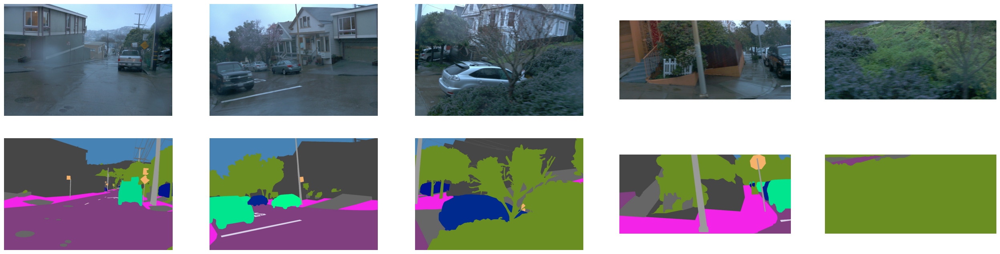

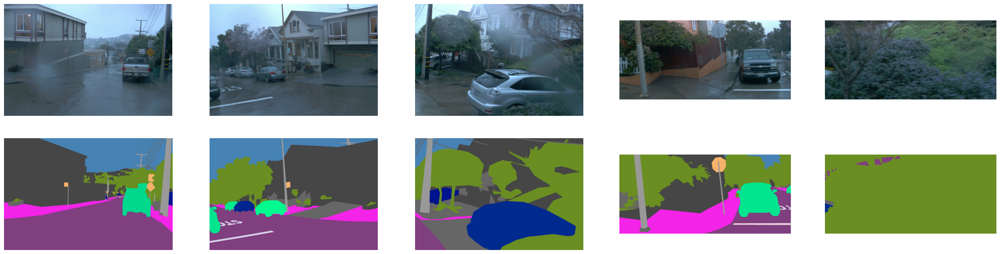

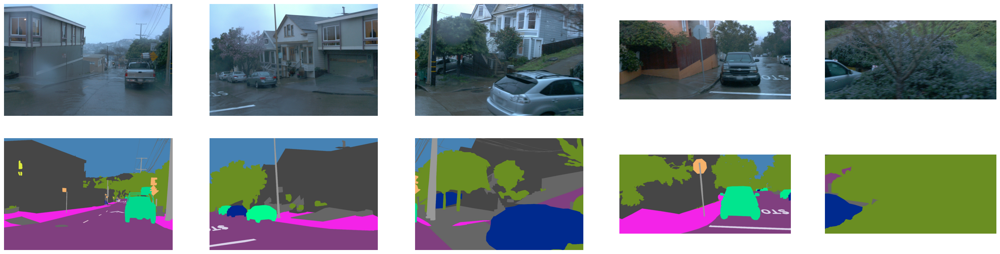

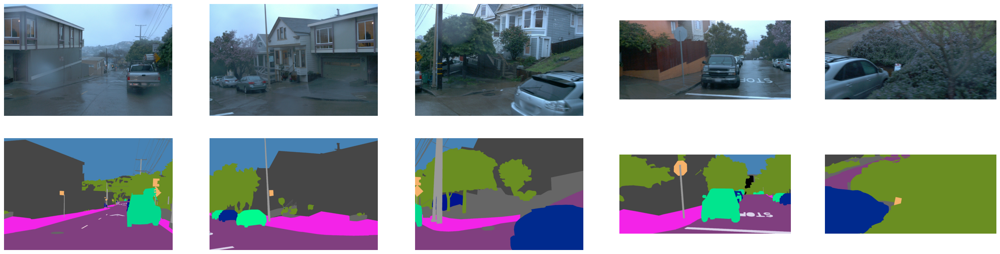

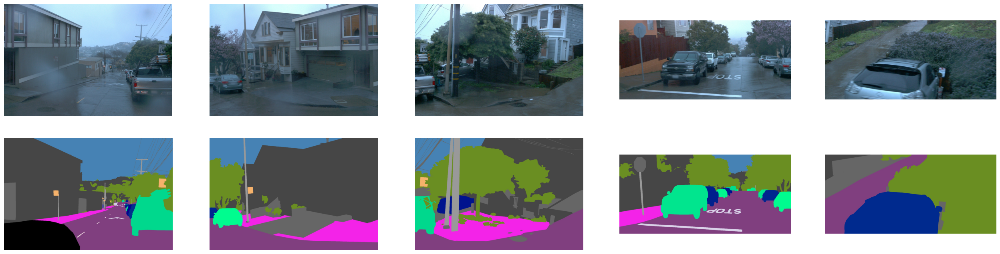

...

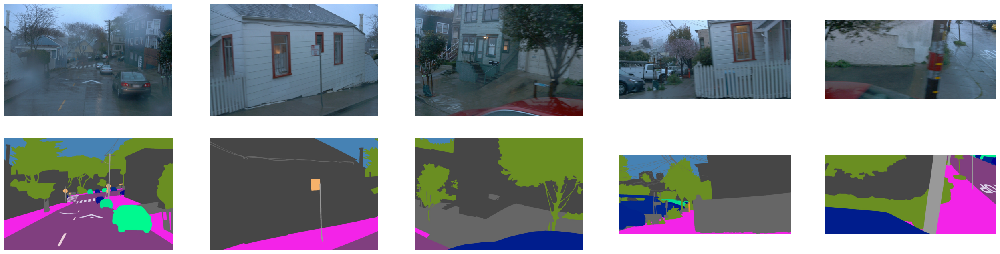

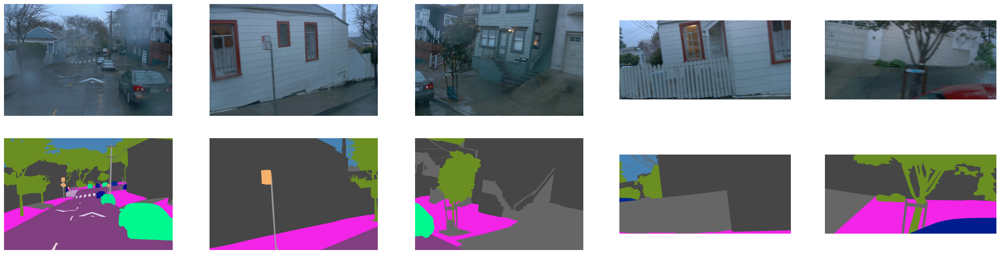

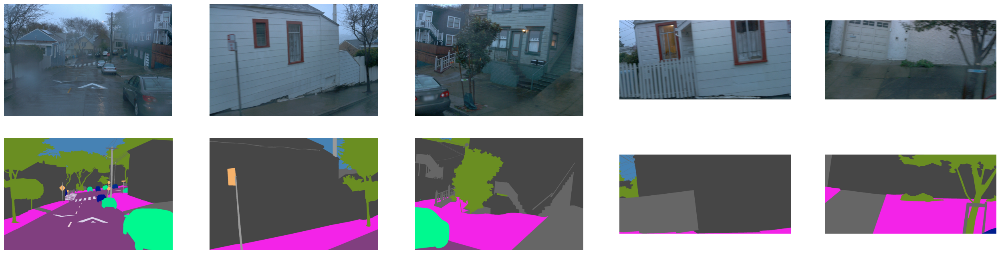

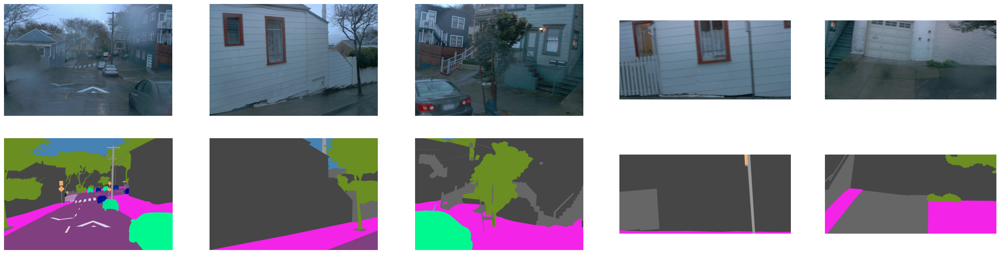

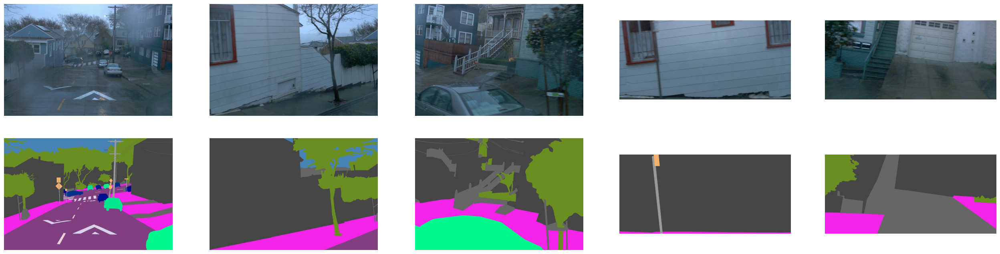

In [63]:
context_name = "10017090168044687777_6380_000_6400_000"
for time_stamp in frames_dict[context_name]:
    img_FRONT = cv2.imread(f"./data/{context_name}/{time_stamp}/img_FRONT.jpg")
    img_FRONT_LEFT = cv2.imread(f"./data/{context_name}/{time_stamp}/img_FRONT_LEFT.jpg")
    img_FRONT_RIGHT = cv2.imread(f"./data/{context_name}/{time_stamp}/img_FRONT_RIGHT.jpg")
    img_SIDE_LEFT = cv2.imread(f"./data/{context_name}/{time_stamp}/img_SIDE_LEFT.jpg")
    img_SIDE_RIGHT = cv2.imread(f"./data/{context_name}/{time_stamp}/img_SIDE_RIGHT.jpg")

    semantic_labels_FRONT = cv2.imread(f"./data/{context_name}/{time_stamp}/semantic_labels_FRONT.jpg")
    semantic_labels_FRONT_LEFT = cv2.imread(f"./data/{context_name}/{time_stamp}/semantic_labels_FRONT_LEFT.jpg")
    semantic_labels_FRONT_RIGHT = cv2.imread(f"./data/{context_name}/{time_stamp}/semantic_labels_FRONT_RIGHT.jpg")
    semantic_labels_SIDE_LEFT = cv2.imread(f"./data/{context_name}/{time_stamp}/semantic_labels_SIDE_LEFT.jpg")
    semantic_labels_SIDE_RIGHT = cv2.imread(f"./data/{context_name}/{time_stamp}/semantic_labels_SIDE_RIGHT.jpg")

    instance_labels_FRONT = cv2.imread(f"./data/{context_name}/{time_stamp}/instance_labels_FRONT.jpg")
    instance_labels_FRONT_LEFT = cv2.imread(f"./data/{context_name}/{time_stamp}/instance_labels_FRONT_LEFT.jpg")
    instance_labels_FRONT_RIGHT = cv2.imread(f"./data/{context_name}/{time_stamp}/instance_labels_FRONT_RIGHT.jpg")
    instance_labels_SIDE_LEFT = cv2.imread(f"./data/{context_name}/{time_stamp}/instance_labels_SIDE_LEFT.jpg")
    instance_labels_SIDE_RIGHT = cv2.imread(f"./data/{context_name}/{time_stamp}/instance_labels_SIDE_RIGHT.jpg")

    panoptic_rgb_labels_FRONT = cv2.imread(f"./data/{context_name}/{time_stamp}/panoptic_rgb_labels_FRONT.jpg")
    panoptic_rgb_labels_FRONT_LEFT = cv2.imread(f"./data/{context_name}/{time_stamp}/panoptic_rgb_labels_FRONT_LEFT.jpg")
    panoptic_rgb_labels_FRONT_RIGHT = cv2.imread(f"./data/{context_name}/{time_stamp}/panoptic_rgb_labels_FRONT_RIGHT.jpg")
    panoptic_rgb_labels_SIDE_LEFT = cv2.imread(f"./data/{context_name}/{time_stamp}/panoptic_rgb_labels_SIDE_LEFT.jpg")
    panoptic_rgb_labels_SIDE_RIGHT = cv2.imread(f"./data/{context_name}/{time_stamp}/panoptic_rgb_labels_SIDE_RIGHT.jpg")
    
    
    rows = 5
    cols = 1
    frames = [[0 for j in range(cols)] for i in range(rows)]
    rows = 5
    cols = 3
    labels = [[0 for j in range(cols)] for i in range(rows)]
    
    frames[0][0] = img_FRONT 
    frames[1][0] = img_FRONT_LEFT 
    frames[2][0] = img_FRONT_RIGHT 
    frames[3][0] = img_SIDE_LEFT 
    frames[4][0] = img_SIDE_RIGHT 
    
    # torch.Size([batch_size, 1, 1280, 1920])
    labels[0][0] = semantic_labels_FRONT 
    labels[1][0] = semantic_labels_FRONT_LEFT 
    labels[2][0] = semantic_labels_FRONT_RIGHT 
    labels[3][0] = semantic_labels_SIDE_LEFT 
    labels[4][0] = semantic_labels_SIDE_RIGHT 
    
    # torch.Size([batch_size, 1, 1280, 1920])
    labels[0][1] = instance_labels_FRONT 
    labels[1][1] = instance_labels_FRONT_LEFT 
    labels[2][1] = instance_labels_FRONT_RIGHT 
    labels[3][1] = instance_labels_SIDE_LEFT 
    labels[4][1] = instance_labels_SIDE_RIGHT 
    
    # torch.Size([batch_size, 3, 1280, 1920])
    labels[0][2] = panoptic_rgb_labels_FRONT 
    labels[1][2] = panoptic_rgb_labels_FRONT_LEFT 
    labels[2][2] = panoptic_rgb_labels_FRONT_RIGHT 
    labels[3][2] = panoptic_rgb_labels_SIDE_LEFT 
    labels[4][2] = panoptic_rgb_labels_SIDE_RIGHT
    
    fig, axs = plt.subplots(2, 5, figsize=(32, 8), subplot_kw={'xticks': [], 'yticks': []})
    for i in range(5):
        img = frames[i][0]
        axs[0, i].imshow(cv2.cvtColor(img, cv2.COLOR_RGB2BGR))
        axs[0, i].axis('off')

    # Plot the remaining 5 images in the second row
    for i in range(5):
        img = labels[i][2]
        axs[1, i].imshow(cv2.cvtColor(img, cv2.COLOR_RGB2BGR))
        axs[1, i].axis('off')

    # Show the plot
    plt.show()